In [1]:
# Import Packages

import geopandas as gpd
import pandas as pd
import numpy as np
import seaborn
import matplotlib.pyplot as plt
import mapclassify
import plotly.express as px
from shapely.geometry import Point
import contextily as cx
from pysal.lib import weights
from pysal.explore import esda
from pysal.model import spreg
from esda.moran import Moran_Local
import statsmodels.formula.api as sm
from splot.esda import moran_scatterplot
from splot.esda import plot_local_autocorrelation
from splot.esda import lisa_cluster

c:\Users\saads\anaconda3\Lib\site-packages\spaghetti\network.py:42: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


### Crime Points Code

In [2]:
# Reading CRIME POINTS file

crimepoints = pd.read_csv('crimepoints.csv')
crimepoints.head(5)


,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,59263678a3b555ff49b56c8139a50ae7d726319ad11696...,2021-03,City of London Police,City of London Police,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Violence and sexual offences,Status update unavailable,NaN
1,b76e47ab9e47e04e113d39a07e5d98ebe26573e2e59c87...,2021-03,City of London Police,City of London Police,-0.109582,51.522017,On or near Clerkenwell Road,E01000916,Camden 027B,Drugs,Status update unavailable,NaN
2,eb03022d768846e0205cb1085ac26f657d522b5d391779...,2021-03,City of London Police,City of London Police,-0.109582,51.522017,On or near Clerkenwell Road,E01000916,Camden 027B,Possession of weapons,Status update unavailable,NaN
3,cb8731ed3a2baf3ea4bb652a2049b3bc407dbbf73d19ee...,2021-03,City of London Police,City of London Police,-0.111497,51.518226,On or near Pedestrian Subway,E01000914,Camden 028B,Burglary,Investigation complete; no suspect identified,NaN
4,51e6cadbbe32c9edcd77d9be18ab0bf0e133e07d026b54...,2021-03,City of London Police,City of London Police,-0.111497,51.518226,On or near Pedestrian Subway,E01000914,Camden 028B,Other theft,Investigation complete; no suspect identified,NaN


<Axes: >

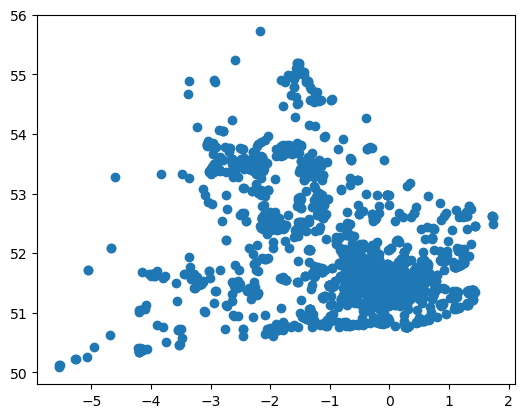

In [3]:
# Identifying points

# Create a GeoDataFrame from the DataFrame
crimepoints = gpd.GeoDataFrame(crimepoints, geometry=gpd.points_from_xy(crimepoints['Longitude'], crimepoints['Latitude']))

# Plot the points. It is noticed that the points dataset covers all the UK.
crimepoints.plot()


In [4]:
# Reading in the 2021 dataset from Project 1 (former CrimeMap_2021)

London_Map_2021 = gpd.read_file('London_Map_2021.geojson')

# Selection of relevant columns
London_Map_2021 = London_Map_2021 [['LSOA Code', 'OA21CD','LSOA21NM','BNG_E','BNG_N','LAT','LONG','GlobalID','2021 Crime/1000 people','2021 Population','2021 Non UK Percentage','Elementary Sum 2021','Elementary Prop 2021','geometry']]
London_Map_2021.head(5)

,LSOA Code,OA21CD,LSOA21NM,BNG_E,BNG_N,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,2021 Non UK Percentage,Elementary Sum 2021,Elementary Prop 2021,geometry
0,E01000001,E00000001,City of London 001A,532250,181864,51.5202,-0.095230,09af0f57-ef7c-448b-b0ba-093649a86e70,121.109608,1478,0.408660,34,0.039171,"POLYGON ((532275.938 181637.750, 532272.750 18..."
1,E01000002,E00000018,City of London 001B,532397,181793,51.5195,-0.093140,b9862ded-2d5e-4f2f-9009-951bb8f6ecae,176.555716,1382,0.450796,15,0.017143,"POLYGON ((532624.323 181842.310, 532626.495 18..."
2,E01000003,E00000010,City of London 001C,532092,182114,51.5225,-0.097410,eee105a5-6df7-41b7-ba8e-d77deb24493f,50.216987,1613,0.429014,95,0.094810,"POLYGON ((532236.500 181891.563, 532224.624 18..."
3,E01000005,E00000029,City of London 001E,533581,181249,51.5144,-0.076290,a5689649-6253-4357-b84c-9fe07fedf0c6,463.570128,1098,0.485428,172,0.348178,"POLYGON ((533615.622 181406.023, 533619.062 18..."
4,E01000006,E00000049,Barking and Dagenham 016A,544816,184464,51.5405,0.086831,148eca51-307b-43e3-a746-8ded9845dabf,51.031488,1842,0.517915,311,0.351016,"POLYGON ((545183.927 184145.062, 545179.170 18..."


In [5]:
# Check the CRS of the crimepoints dataset
print(crimepoints.crs)
London_Map_2021.crs = 'EPSG:27700'
print(London_Map_2021.crs)

# Changing the crs of points from non to EPSG:4326 (latitud and longitud)
crimepoints.crs = 'EPSG:4326'

print(crimepoints.crs)


None
EPSG:27700
EPSG:4326


In [6]:
# Reproject points to EPSG 27700. This had to be done so that the points align with the LSOA polygons.
crimepoints_reprojected = crimepoints.to_crs(London_Map_2021.crs)

In [7]:
# As I mentiond before the points were for all UK, so I performed a spatial join to determine which LSOA each point belongs to
London_Crime_Points = gpd.sjoin(crimepoints_reprojected, London_Map_2021, op='within')
London_Crime_Points = London_Crime_Points.reset_index(drop=True)

# This reduces the dataset to only the geometry of the points. This might keep it simple to calculate distances.
Crime_Points_GeomOnly = London_Crime_Points[['geometry']]


c:\Users\saads\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py:3493: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [8]:
# View of the points within London Only

London_Crime_Points.head(5)

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,...,BNG_E,BNG_N,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,2021 Non UK Percentage,Elementary Sum 2021,Elementary Prop 2021
0,59263678a3b555ff49b56c8139a50ae7d726319ad11696...,2021-03,City of London Police,City of London Police,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Violence and sexual offences,...,530110,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913
1,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Anti-social behaviour,...,530110,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913
2,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126699,51.533442,On or near Goods Way,E01000953,Camden 022B,Anti-social behaviour,...,530110,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913
3,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.122678,51.535167,On or near Petrol Station,E01000953,Camden 022B,Anti-social behaviour,...,530110,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913
4,032c65a78e935a164f4dc13877de2364976669a77cbc82...,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.123643,51.530264,On or near Pedestrian Subway,E01000953,Camden 022B,Bicycle theft,...,530110,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913


In [9]:
# This is the geometry of the crime points

Crime_Points_GeomOnly.head(5)

,geometry
0,POINT (530058.981 183063.966)
1,POINT (530058.981 183063.966)
2,POINT (530031.014 183278.014)
3,POINT (530304.970 183476.989)
4,POINT (530252.028 182930.040)


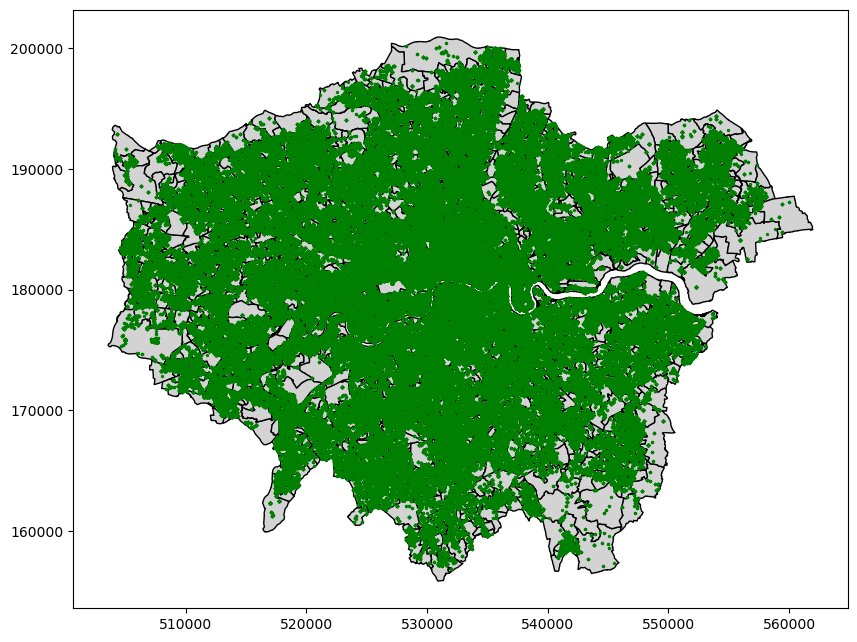

In [10]:
# Map to show that polygons and points are in the right format. THIS IS JUST A CHECK. 
fig, ax = plt.subplots(figsize=(10, 10))
London_Map_2021.plot(ax=ax, color='lightgrey', edgecolor='black')
Crime_Points_GeomOnly.plot(ax=ax, color='green',markersize=2)
plt.show()


### Education/Qualification Data

In [11]:
#Load London all 7 2021 education levels and numbers of 16+ persons, per LSOA 
Edu_2021 = pd.read_excel('London2021_Qualifications.xlsx', sheet_name= '2021')
Edu_2021 = Edu_2021 [['LSOA code', 'Usual residents aged 16+','none','Level 1','Level 2','Apprentice-ship','Level 3','Level 4+','Other']]
Edu_2021 = Edu_2021.rename(columns={'LSOA code': 'LSOA Code'})


In [12]:
Edu_2021.head()

,LSOA Code,Usual residents aged 16+,none,Level 1,Level 2,Apprentice-ship,Level 3,Level 4+,Other
0,E01000001,1353,32,26,54,13,86,1126,16
1,E01000002,1300,23,28,52,4,89,1086,18
2,E01000003,1505,132,61,90,12,121,1055,34
3,E01000005,958,197,61,122,32,130,387,29
4,E01000006,1429,295,155,170,38,206,499,66


In [13]:
#merge London education levels with the London map
London_Map_2021 = London_Map_2021.merge(Edu_2021, on = 'LSOA Code', how='outer' )
London_Map_2021['Level0_1'] = London_Map_2021['none'] + London_Map_2021['Level 1']



In [14]:
London_Map_2021.head()

,LSOA Code,OA21CD,LSOA21NM,BNG_E,BNG_N,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,...,geometry,Usual residents aged 16+,none,Level 1,Level 2,Apprentice-ship,Level 3,Level 4+,Other,Level0_1
0,E01000001,E00000001,City of London 001A,532250,181864,51.5202,-0.095230,09af0f57-ef7c-448b-b0ba-093649a86e70,121.109608,1478,...,"POLYGON ((532275.938 181637.750, 532272.750 18...",1353,32,26,54,13,86,1126,16,58
1,E01000002,E00000018,City of London 001B,532397,181793,51.5195,-0.093140,b9862ded-2d5e-4f2f-9009-951bb8f6ecae,176.555716,1382,...,"POLYGON ((532624.323 181842.310, 532626.495 18...",1300,23,28,52,4,89,1086,18,51
2,E01000003,E00000010,City of London 001C,532092,182114,51.5225,-0.097410,eee105a5-6df7-41b7-ba8e-d77deb24493f,50.216987,1613,...,"POLYGON ((532236.500 181891.563, 532224.624 18...",1505,132,61,90,12,121,1055,34,193
3,E01000005,E00000029,City of London 001E,533581,181249,51.5144,-0.076290,a5689649-6253-4357-b84c-9fe07fedf0c6,463.570128,1098,...,"POLYGON ((533615.622 181406.023, 533619.062 18...",958,197,61,122,32,130,387,29,258
4,E01000006,E00000049,Barking and Dagenham 016A,544816,184464,51.5405,0.086831,148eca51-307b-43e3-a746-8ded9845dabf,51.031488,1842,...,"POLYGON ((545183.927 184145.062, 545179.170 18...",1429,295,155,170,38,206,499,66,450


In [15]:
##getting number of people with different qualification levels per 1000 people (to line up with Crime rates)
London_Map_2021['No qualification/1000 people'] = (London_Map_2021['none']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Level 1/1000 people'] = (London_Map_2021['Level 1']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Level0_1/1000 people'] = (London_Map_2021['Level0_1']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Level 2/1000 people'] = (London_Map_2021['Level 2']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Level 3/1000 people'] = (London_Map_2021['Level 3']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Level 4/1000 people'] = (London_Map_2021['Level 4+']/(London_Map_2021['Usual residents aged 16+'])*1000)
London_Map_2021['Apprenticeship/1000 people'] = (London_Map_2021['Apprentice-ship']/(London_Map_2021['Usual residents aged 16+'])*1000)

London_Map_2021.head()

qualification_values = [
    ('London_Map_2021_no_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['No qualification/1000 people']), 3)),
    ('London_Map_2021_level1_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Level 1/1000 people']), 3)),
    ('London_Map_2021_level0_1_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Level0_1/1000 people']), 3)),
    ('London_Map_2021_level2_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Level 2/1000 people']), 3)),
    ('London_Map_2021_level3_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Level 3/1000 people']), 3)),
    ('London_Map_2021_level4_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Level 4/1000 people']), 3)),
    ('London_Map_2021_Apprenticeship_qualification', round(London_Map_2021['2021 Crime/1000 people'].corr(London_Map_2021['Apprenticeship/1000 people']), 3))
]

for variable, value in qualification_values:
    print(f"{variable}: {value}")


London_Map_2021_no_qualification: -0.031
London_Map_2021_level1_qualification: -0.111
London_Map_2021_level0_1_qualification: -0.059
London_Map_2021_level2_qualification: -0.196
London_Map_2021_level3_qualification: -0.034
London_Map_2021_level4_qualification: 0.094
London_Map_2021_Apprenticeship_qualification: -0.116


### Spatial Correlation Analysis

In [16]:
# Creation of Spatial Weight Matrix (W) from the London_Map_2021
w = weights.Queen.from_dataframe(London_Map_2021)
# Row-standardization
w.transform = 'R'

C:\Users\saads\AppData\Local\Temp\ipykernel_31624\2594347835.py:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(London_Map_2021)


#### Spatial Lag 

In [17]:
# Calculation of spatial lag

London_Map_2021_SpatialCorr = London_Map_2021.copy() # Creating a copy just in case
London_Map_2021_SpatialCorr['CrimeRate_Lag'] = weights.spatial_lag.lag_spatial(w, London_Map_2021_SpatialCorr['2021 Crime/1000 people'])

Text(0.5, 1.0, 'Spatial Lag: 2021 London Crime Rate by LSOA')

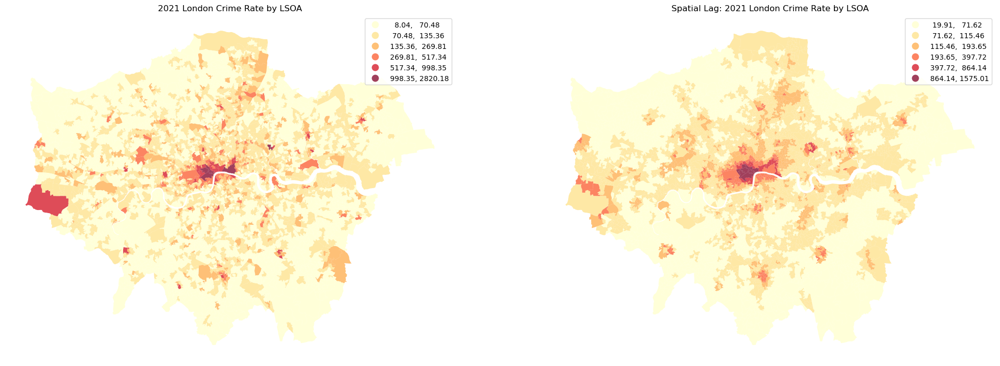

In [18]:
# Ploting the original crime rate values and the spatial lag values side by side

f, axs = plt.subplots(1, 2, figsize=(25, 20))
ax1, ax2 = axs

London_Map_2021_SpatialCorr.to_crs('EPSG:3857').plot(column='2021 Crime/1000 people', cmap='YlOrRd', scheme='FisherJenks',
        k=6, edgecolor='white', linewidth=0., alpha=0.75, legend=True, ax=ax1)
ax1.set_axis_off()
ax1.set_title("2021 London Crime Rate by LSOA")
#cx.add_basemap(ax1, source=cx.providers.CartoDB.Voyager)

London_Map_2021_SpatialCorr.to_crs('EPSG:3857').plot(column='CrimeRate_Lag', cmap='YlOrRd', scheme='FisherJenks',
        k=6, edgecolor='white', linewidth=0., alpha=0.75, legend=True, ax=ax2)
ax2.set_axis_off()
ax2.set_title("Spatial Lag: 2021 London Crime Rate by LSOA")
#cx.add_basemap(ax2, source=cx.providers.CartoDB.Voyager)

<Axes: xlabel='High', ylabel='2021 Crime/1000 people'>

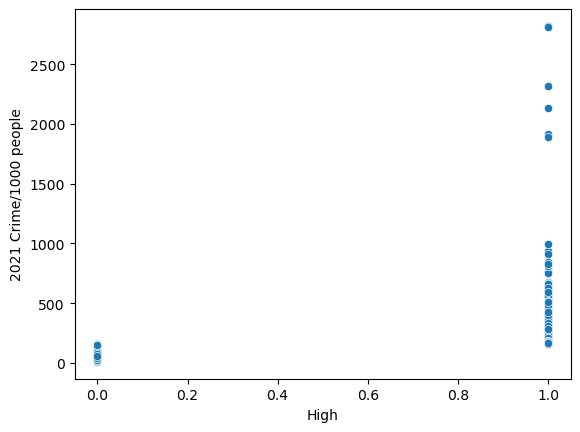

In [19]:
# Classification of High crime rate values. I selected 157 as a threshold as this represents the upper whisker of the boxplot in the previous project. 
London_Map_2021_SpatialCorr['High'] = (London_Map_2021_SpatialCorr['2021 Crime/1000 people'] > 157).astype(int)
seaborn.scatterplot(data=London_Map_2021_SpatialCorr, x="High", y="2021 Crime/1000 people")

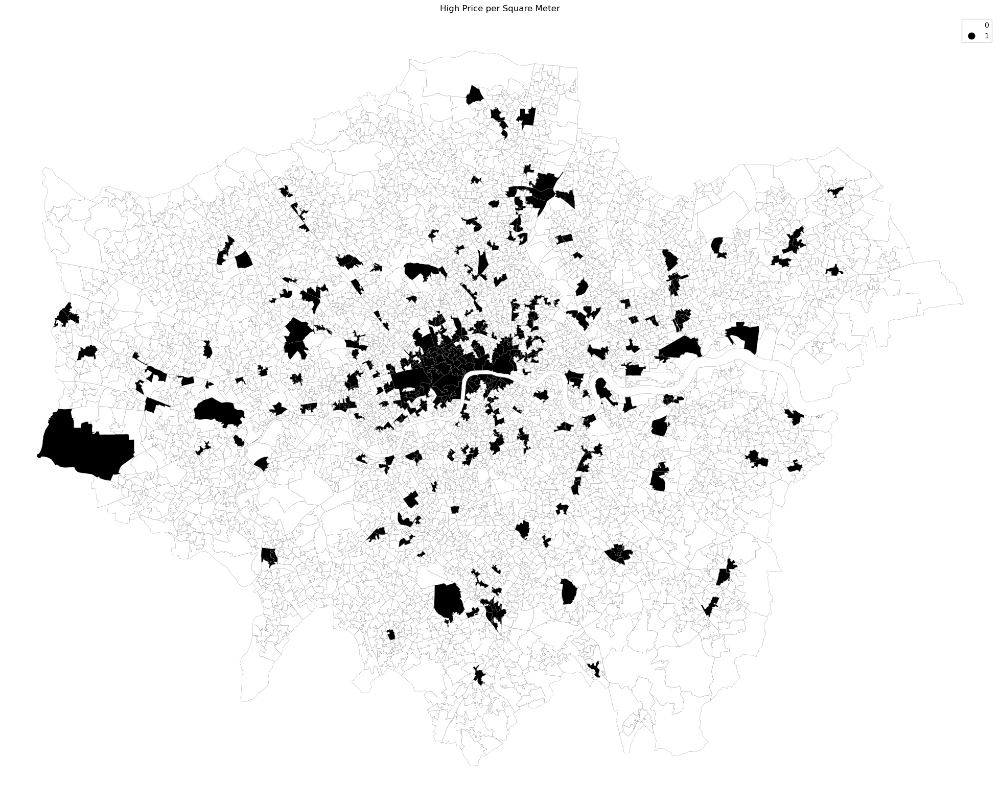

In [20]:
f, ax = plt.subplots(1, figsize=(25, 20))
London_Map_2021_SpatialCorr.plot(ax=ax, column='High', categorical=True, legend=True, 
        edgecolor='0.5', linewidth=0.25, cmap='Greys');
ax.set_axis_off()
ax.set_title('High Price per Square Meter')
plt.axis('equal')
plt.show()

In [21]:
w.transform = 'O' #Transform weights matrix back to non-standardized state in order to sum total counts
jc = esda.join_counts.Join_Counts(London_Map_2021_SpatialCorr['High'], w)

In [22]:
# Count of black - black joints 

jc.bb

341.0

In [23]:
# Count of white - white joints 

jc.ww

12589.0

In [24]:
# Count of black-white joints

jc.bw

1804.0

In [25]:
# Number of rows in the dataset
len(London_Map_2021_SpatialCorr)

4994

In [26]:
# 14791/4994 = 2.96 ~ 3 neighbours per observation

jc.bb + jc.ww + jc.bw

14734.0

In [27]:
# expected value of black-black joints

jc.mean_bb

79.43943943943944

In [28]:
# expecteed value of black-white joints

jc.mean_bw

2007.3843843843845

In [29]:
# Statistical significance, we reject H0: black and white LSOAs are randonly distributed

jc.p_sim_bb

0.001

#### Moran's I

In [30]:
# Start by standarasing the variables in terms of units of standard deviation

London_Map_2021_SpatialCorr['CR_std'] = ( London_Map_2021_SpatialCorr['2021 Crime/1000 people'] - London_Map_2021_SpatialCorr['2021 Crime/1000 people'].mean() )\
                    / London_Map_2021_SpatialCorr['2021 Crime/1000 people'].std()
London_Map_2021_SpatialCorr['CR_lag_std'] = ( London_Map_2021_SpatialCorr['CrimeRate_Lag'] - London_Map_2021_SpatialCorr['CrimeRate_Lag'].mean() )\
                    / London_Map_2021_SpatialCorr['CrimeRate_Lag'].std()

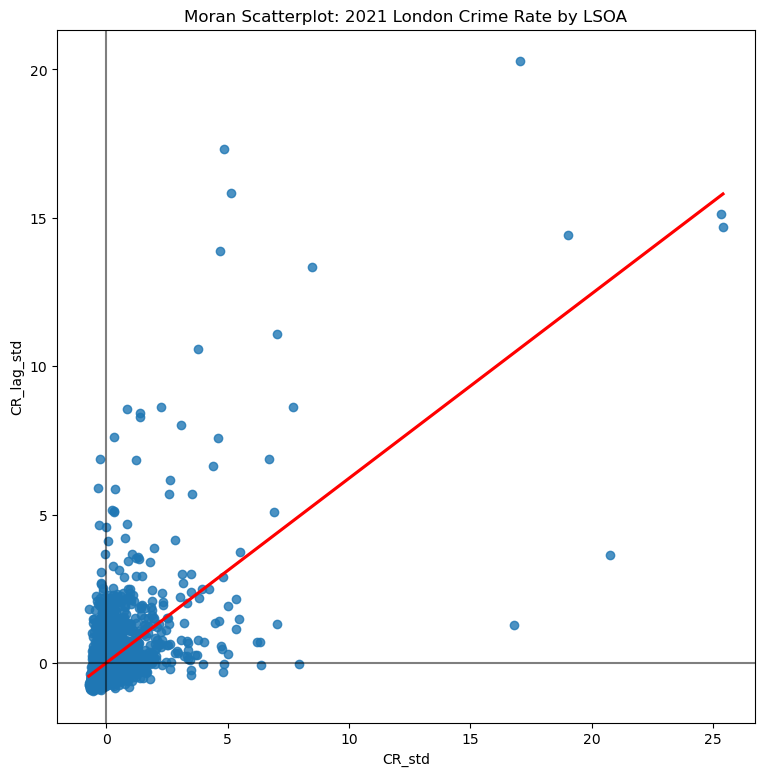

In [31]:
# Moran Scatterplot 

f, ax = plt.subplots(1, figsize=(9, 9))

seaborn.regplot(x='CR_std', y='CR_lag_std', 
                ci=None, data=London_Map_2021_SpatialCorr, line_kws={'color':'r'})
ax.axvline(0, c='k', alpha=0.5)
ax.axhline(0, c='k', alpha=0.5)
ax.set_title('Moran Scatterplot: 2021 London Crime Rate by LSOA')
plt.show()

In [32]:
# Calculation of Moran's I value

w.transform = 'R' # back to standarised values
moran = esda.Moran(London_Map_2021_SpatialCorr['2021 Crime/1000 people'], w)
moran.I

0.4231991409916194

In [33]:
# Calculation of statistical significance - p-value

moran.p_sim

0.001

C:\Users\saads\AppData\Local\Temp\ipykernel_31624\3947482095.py:1: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  seaborn.kdeplot(moran.sim, shade=True)
c:\Users\saads\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


(-0.1, 0.5)

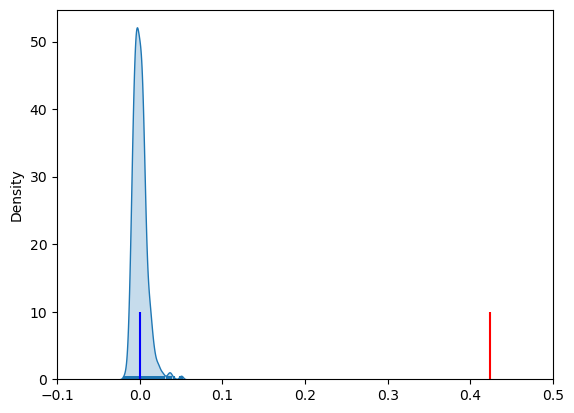

In [34]:
seaborn.kdeplot(moran.sim, shade=True)
plt.vlines(moran.sim, 0, 0.5)
plt.vlines(moran.I, 0, 10, 'red')
plt.vlines(moran.EI, 0, 10, 'blue') #Expected value of I
plt.xlim([-0.1, 0.5])

#### LISA Analysis

In [35]:
# Calculation of Local Moran's I

moran_loc = Moran_Local(London_Map_2021_SpatialCorr['2021 Crime/1000 people'], w, permutations=9999)

In [36]:
# Testing FDA

moran_values = moran_loc.Is
p_values = moran_loc.p_sim
London_Map_2021_SpatialCorr['moran_values']= moran_values
London_Map_2021_SpatialCorr['LISA p-values']= p_values
London_Map_2021_FDR = London_Map_2021_SpatialCorr
London_Map_2021_FDR = London_Map_2021_FDR.sort_values(by='LISA p-values', ascending=True)
London_Map_2021_FDR['i'] = London_Map_2021_FDR.reset_index().index+1
London_Map_2021_FDR['FDR'] = (London_Map_2021_FDR['i']/len(London_Map_2021_FDR)) * 0.01
London_Map_2021_FDR.head(5)


,LSOA Code,OA21CD,LSOA21NM,BNG_E,BNG_N,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,...,Level 4/1000 people,Apprenticeship/1000 people,CrimeRate_Lag,High,CR_std,CR_lag_std,moran_values,LISA p-values,i,FDR
419,E01000436,E00002146,Bexley 011E,548680,177108,51.4734,0.139409,dc66547e-db45-4be8-9b2e-0e2a75c8e3c9,18.181818,1760,...,277.658815,64.953605,22.844847,0,-0.620950,-0.910302,0.358682,0.0001,1,0.000002
4477,E01004731,E00023941,Westminster 020A,529506,179381,51.4985,-0.135660,fcddb830-69aa-4e2f-8fc8-7d8b608f8cae,361.649280,2013,...,704.927212,17.917133,506.839000,1,2.569630,5.697957,10.068691,0.0001,2,0.000004
4479,E01004733,E00023927,Westminster 020C,529815,179092,51.4959,-0.131320,0b66d5da-d4d4-4713-9df8-5d5563a6f5e1,327.908090,2089,...,668.290043,12.445887,721.966336,1,2.256197,8.635218,13.349308,0.0001,3,0.000006
4480,E01004734,E00023928,Westminster 018A,529957,180795,51.5111,-0.128650,97449265-4288-45b7-b86a-bc9956502696,2820.178042,1685,...,565.162907,25.062657,1165.310340,1,25.407693,14.688457,254.968616,0.0001,4,0.000008
4481,E01004735,E00023932,Westminster 018B,530335,180973,51.5126,-0.123140,ecc17d7a-063e-4c82-a341-2a6adff11260,841.949778,2031,...,584.936778,21.440352,901.099811,1,7.031295,11.081034,53.302552,0.0001,5,0.000010


In [37]:
# FDA Retuls - There is no significant retuls using FDA

London_Map_2021_FDR['FDR Check'] = London_Map_2021_FDR['LISA p-values'] < London_Map_2021_FDR['FDR']
(London_Map_2021_FDR['FDR Check'] == True).sum()

69

In [38]:
# Testing Bonferroni Method

# Number of observations
n = 4994

# Desired family-wise error rate
alpha = 0.05

# Bonferroni corrected significance level
bonferroni_alpha = alpha / n
bonferroni_alpha

1.0012014417300761e-05

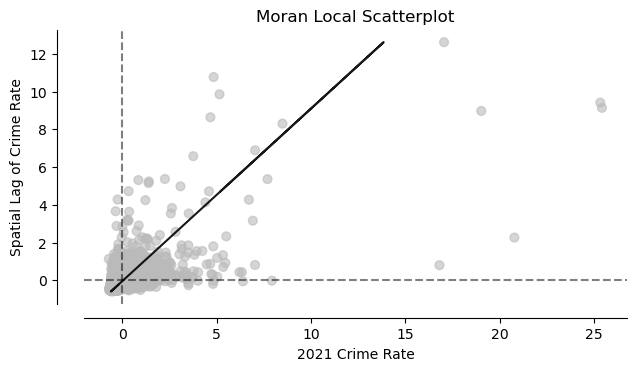

In [39]:
# As the numeber of observations is too high, no results are significant

f, ax = moran_scatterplot(moran_loc, p=bonferroni_alpha)
ax.set_xlabel('2021 Crime Rate')
ax.set_ylabel('Spatial Lag of Crime Rate')
plt.show()

##### alpha = 0.01

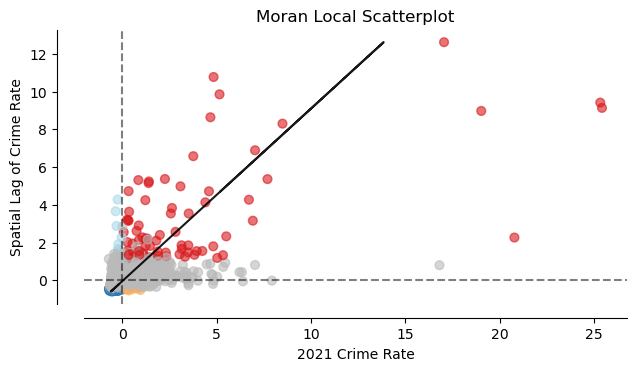

In [40]:
f, ax = moran_scatterplot(moran_loc, p=0.01)
ax.set_xlabel('2021 Crime Rate')
ax.set_ylabel('Spatial Lag of Crime Rate')
plt.show()

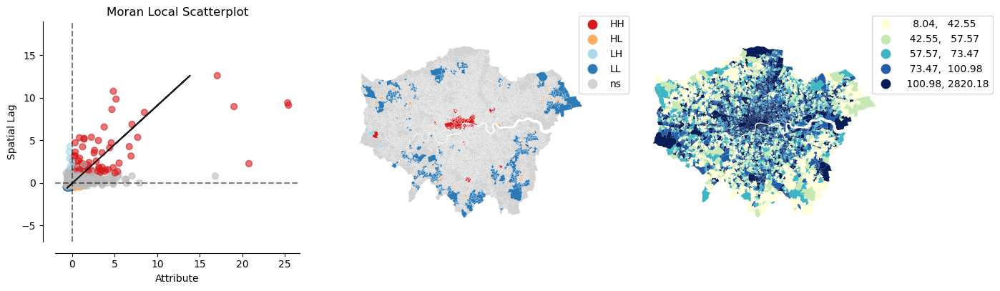

In [41]:
plot_local_autocorrelation(moran_loc, London_Map_2021_SpatialCorr, '2021 Crime/1000 people', p=0.01)
plt.show()

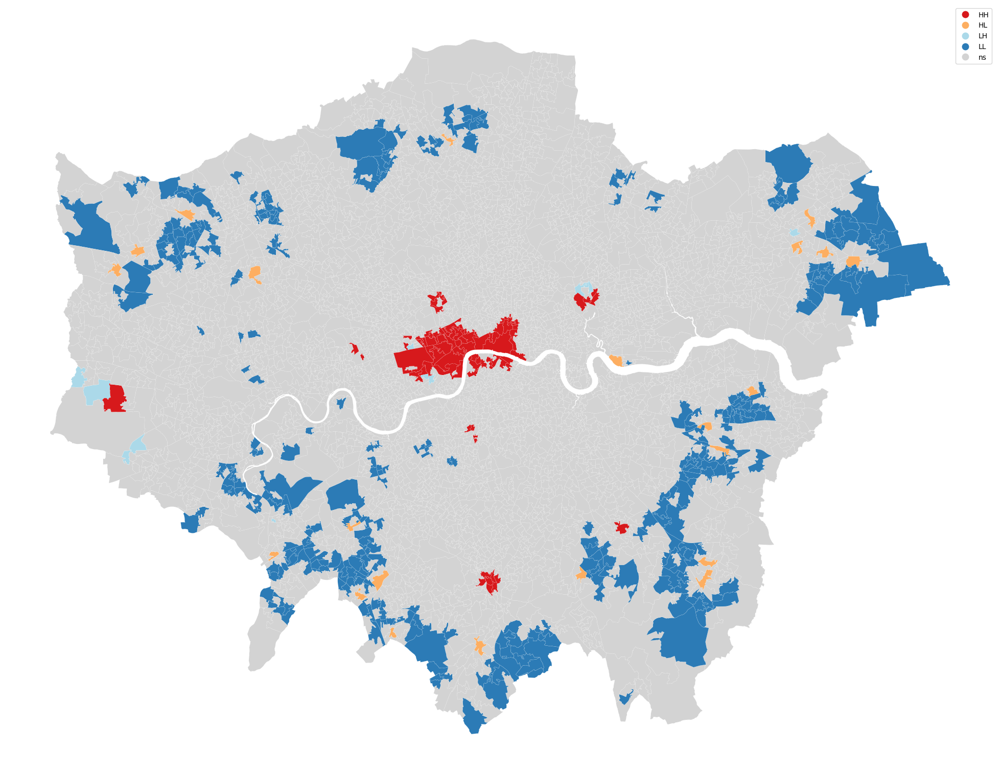

In [42]:
lisa_cluster(moran_loc, London_Map_2021_SpatialCorr, p=0.01, figsize = (25,20))
plt.show()

p-value = 0.1

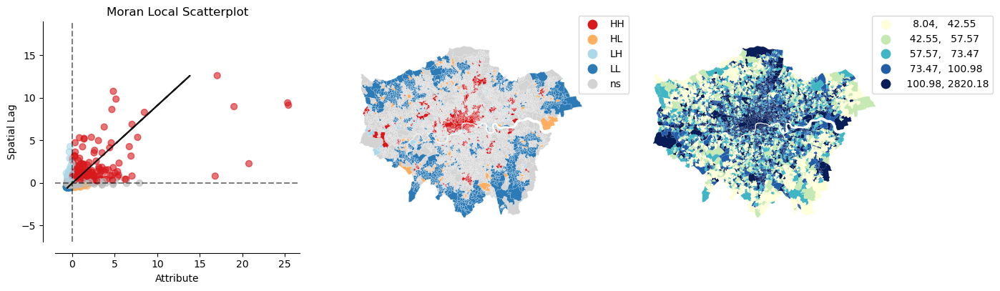

In [43]:
plot_local_autocorrelation(moran_loc, London_Map_2021_SpatialCorr, '2021 Crime/1000 people', p=0.1)
plt.show()

p-value = 0.05

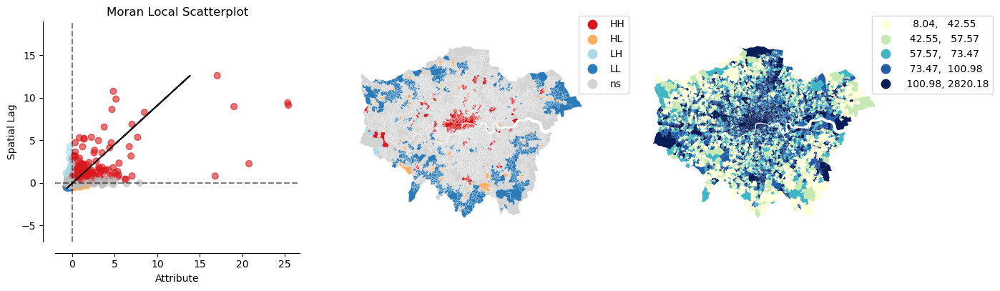

In [44]:
plot_local_autocorrelation(moran_loc, London_Map_2021_SpatialCorr, '2021 Crime/1000 people', p=0.05)
plt.show()

p-value = 0.001

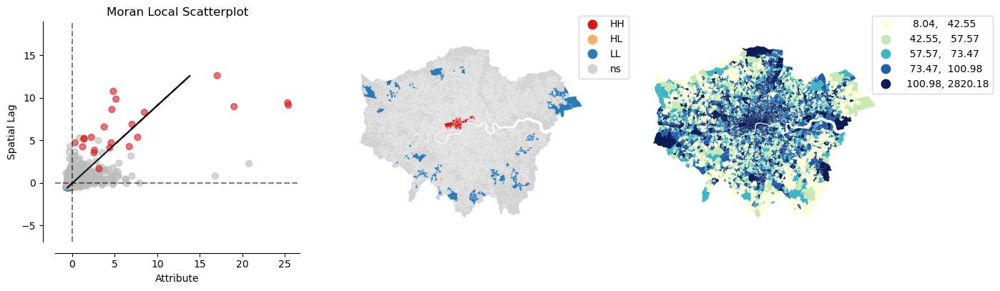

In [45]:
plot_local_autocorrelation(moran_loc, London_Map_2021_SpatialCorr, '2021 Crime/1000 people', p=0.001)
plt.show()

### Exploratory Spatial Regression Model

#### Qualification

Regression for the crime rate by LSOA against the rate of "level 0" (no qualification) and "level 1" qualification by LSOA.

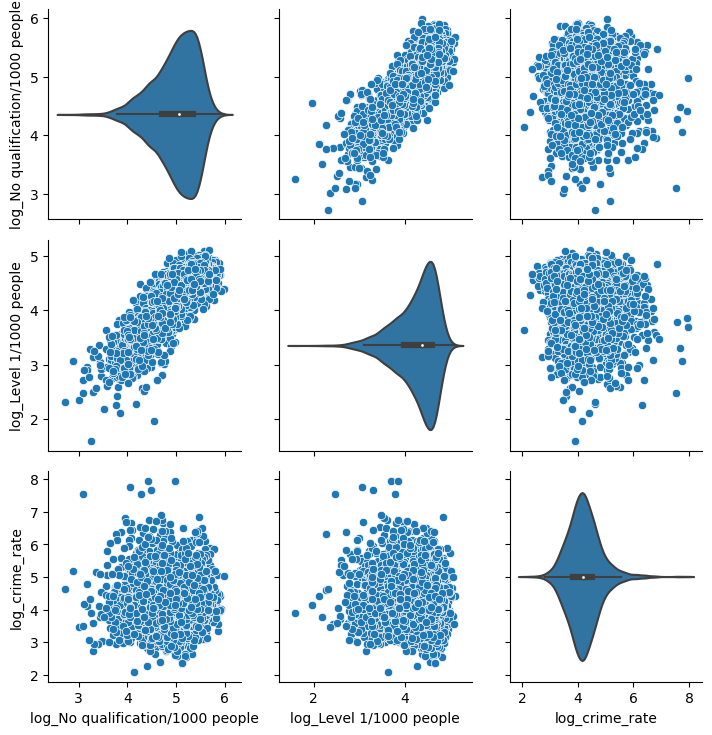

In [46]:
tmp = London_Map_2021.copy()

log_education = np.log(tmp[['Level 1/1000 people', 'Level 2/1000 people', 'Level 3/1000 people', 'Level 4/1000 people', 'Apprenticeship/1000 people', 'No qualification/1000 people']])
log_education.rename(columns=lambda x: 'log_' + x, inplace=True)
log_education['log_crime_rate'] = np.log(tmp['2021 Crime/1000 people'])
log_education['geometry'] = tmp['geometry']

fig = seaborn.PairGrid(log_education, vars = ['log_No qualification/1000 people', 'log_Level 1/1000 people', 'log_crime_rate'])
fig.map_diag(seaborn.violinplot)
fig.map_offdiag(seaborn.scatterplot)

c:\Users\saads\anaconda3\Lib\site-packages\libpysal\weights\util.py:826: UserWarning: The weights matrix is not fully connected: 
 There are 1028 disconnected components.
 There are 779 islands with ids: 22, 23, 26, 27, 29, 30, 34, 65, 68, 80, 83, 87, 88, 95, 99, 105, 126, 138, 153, 154, 155, 171, 175, 181, 182, 188, 192, 193, 199, 201, 208, 215, 219, 227, 235, 236, 237, 240, 241, 242, 243, 245, 246, 247, 248, 252, 262, 264, 265, 266, 268, 272, 276, 277, 291, 295, 301, 311, 314, 315, 317, 321, 335, 341, 348, 350, 351, 356, 360, 361, 362, 363, 364, 366, 367, 368, 369, 370, 371, 372, 374, 375, 376, 385, 387, 391, 392, 401, 408, 411, 412, 414, 417, 419, 427, 428, 430, 431, 432, 441, 444, 445, 449, 453, 455, 468, 469, 473, 497, 499, 515, 516, 539, 540, 545, 546, 554, 584, 587, 594, 595, 616, 619, 620, 622, 624, 625, 626, 627, 628, 629, 630, 631, 632, 634, 635, 636, 637, 638, 639, 640, 641, 646, 647, 648, 649, 651, 653, 654, 655, 656, 657, 658, 662, 663, 664, 665, 666, 667, 681, 682, 683, 6

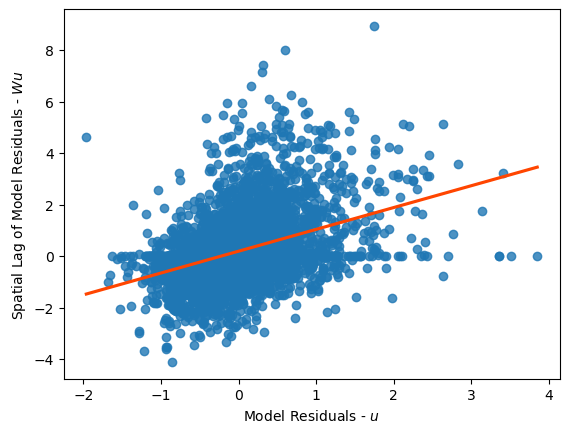

In [47]:
## spatial lag 

m1 = spreg.OLS(log_education[['log_crime_rate']].values, log_education[['log_No qualification/1000 people', 'log_Level 1/1000 people']].values)

w = weights.DistanceBand.from_dataframe(log_education, 500) # Weights based on features within 500 meters
lag_residual = weights.spatial_lag.lag_spatial(w, m1.u)
ax = seaborn.regplot(
    x=m1.u.flatten(),
    y=lag_residual.flatten(),
    line_kws=dict(color='orangered'),
    ci=None,
)
ax.set_xlabel('Model Residuals - $u$')
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$');

In [48]:
log_education.head()

,log_Level 1/1000 people,log_Level 2/1000 people,log_Level 3/1000 people,log_Level 4/1000 people,log_Apprenticeship/1000 people,log_No qualification/1000 people,log_crime_rate,geometry
0,2.955772,3.686660,4.152023,6.724102,2.262625,3.163412,4.796696,"POLYGON ((532275.938 181637.750, 532272.750 18..."
1,3.069840,3.688879,4.226272,6.727892,1.123930,2.873130,5.173636,"POLYGON ((532624.323 181842.310, 532626.495 18..."
2,3.702081,4.091017,4.386998,6.552503,2.076114,4.474009,3.916353,"POLYGON ((532236.500 181891.563, 532224.624 18..."
3,4.153781,4.846929,4.910442,6.001332,3.508643,5.326111,6.138958,"POLYGON ((533615.622 181406.023, 533619.062 18..."
4,4.686450,4.778824,4.970901,5.855631,3.280611,5.330000,3.932443,"POLYGON ((545183.927 184145.062, 545179.170 18..."


('WARNING: ', 22, ' is an island (no neighbors)')
('WARNING: ', 23, ' is an island (no neighbors)')
('WARNING: ', 26, ' is an island (no neighbors)')
('WARNING: ', 27, ' is an island (no neighbors)')
('WARNING: ', 29, ' is an island (no neighbors)')
('WARNING: ', 30, ' is an island (no neighbors)')
('WARNING: ', 34, ' is an island (no neighbors)')
('WARNING: ', 65, ' is an island (no neighbors)')
('WARNING: ', 68, ' is an island (no neighbors)')
('WARNING: ', 80, ' is an island (no neighbors)')
('WARNING: ', 83, ' is an island (no neighbors)')
('WARNING: ', 87, ' is an island (no neighbors)')
('WARNING: ', 88, ' is an island (no neighbors)')
('WARNING: ', 95, ' is an island (no neighbors)')
('WARNING: ', 99, ' is an island (no neighbors)')
('WARNING: ', 105, ' is an island (no neighbors)')
('WARNING: ', 126, ' is an island (no neighbors)')
('WARNING: ', 138, ' is an island (no neighbors)')
('WARNING: ', 153, ' is an island (no neighbors)')
('WARNING: ', 154, ' is an island (no neighbor

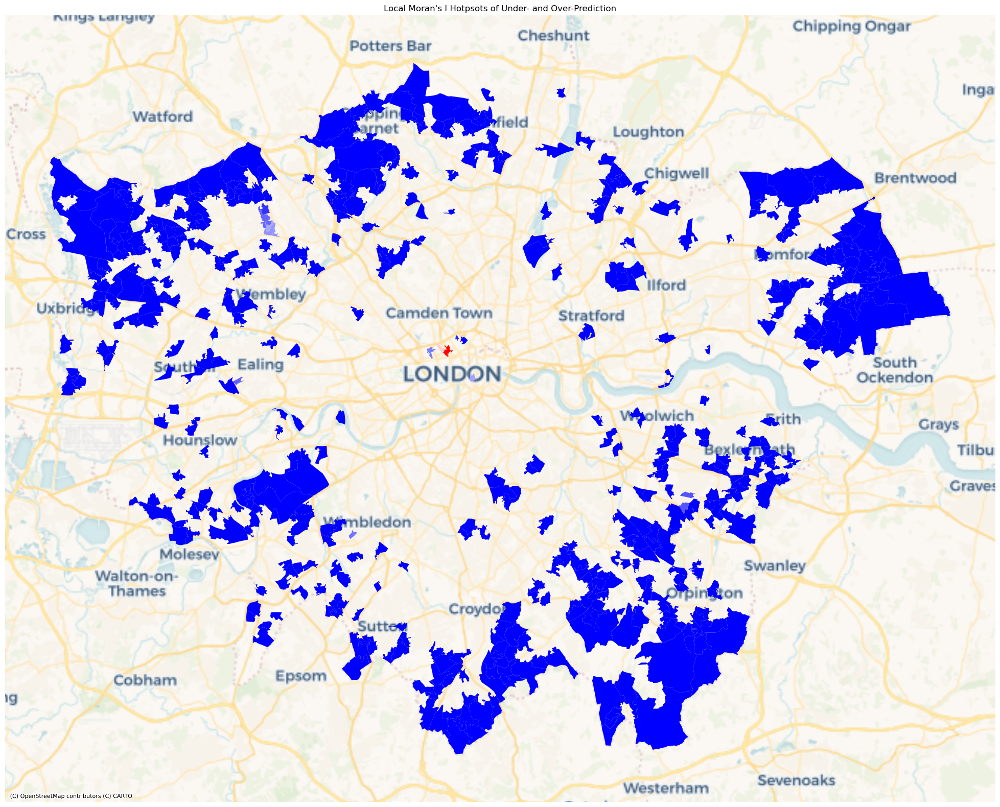

In [49]:

outliers = esda.moran.Moran_Local(m1.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters
f, ax = plt.subplots(1, figsize=(25, 20)) #Subplots allows you to draw multiple plots in one figure
tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='bwr', marker='.', ax=ax)
ax.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction")
ax.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

#### Overground Station

Regression for the number of crime case by LSOA against the mean of shortest distance between each crime case and the overground stations.

In [50]:
# Read and draw overground stations

overground = gpd.read_file('overground_stations.geojson')
overground.crs = 'EPSG:4326'
stations_reprojected = overground.to_crs(London_Map_2021.crs)

overground_Points = gpd.sjoin(stations_reprojected, London_Map_2021, op='within')
overground_Points = overground_Points.reset_index(drop=True)

# This reduces the dataset to only the geometry of the points. This might keep it simple to calculate distances.
overground_Points_GeomOnly = overground_Points[['geometry']]

fig, ax = plt.subplots(figsize=(10, 10))
London_Map_2021.plot(ax=ax, color='lightgrey', edgecolor='grey')
overground_Points_GeomOnly.plot(ax=ax, color='red',markersize=2)
plt.show()

DriverError: overground_stations.geojson: No such file or directory

In [ ]:
## The nearest distance to the overground station for each crime case

crimepoints = London_Crime_Points.copy()
crimepoints['min_distance_overground'] = crimepoints.geometry.apply(lambda x: overground_Points_GeomOnly.distance(x).min())
crimepoints.head()

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,...,BNG_N,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,2021 Non UK Percentage,Elementary Sum 2021,Elementary Prop 2021,min_distance_overground
0,59263678a3b555ff49b56c8139a50ae7d726319ad11696...,2021-03,City of London Police,City of London Police,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Violence and sexual offences,...,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,122.439971
1,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Anti-social behaviour,...,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,122.439971
2,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126699,51.533442,On or near Goods Way,E01000953,Camden 022B,Anti-social behaviour,...,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,331.746316
3,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.122678,51.535167,On or near Petrol Station,E01000953,Camden 022B,Anti-social behaviour,...,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,486.026584
4,032c65a78e935a164f4dc13877de2364976669a77cbc82...,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.123643,51.530264,On or near Pedestrian Subway,E01000953,Camden 022B,Bicycle theft,...,183405,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,85.531956


In [ ]:
# Now we group the crime case data by the LSOA code then aggregate the mean of distances

crimepoints_grouped = crimepoints.groupby('LSOA code').agg({'min_distance_overground': 'mean', 'GlobalID': 'count'}).reset_index()
crimepoints_grouped.rename(columns={'min_distance_overground': 'mean_min_distance_overground', 'LSOA code': 'LSOA Code', 'GlobalID': 'CaseCount'}, inplace=True)
tmp = tmp.merge(crimepoints_grouped, on='LSOA Code', how='left')

In [ ]:
tmp['CasePerAreaUnit'] = tmp['CaseCount']/tmp.geometry.area

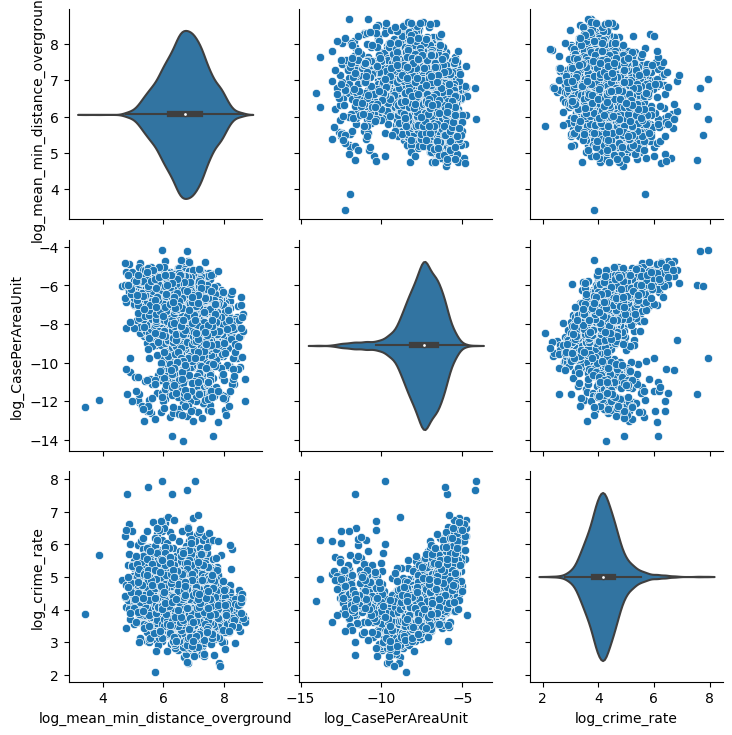

In [ ]:
log_overground = np.log(tmp[['mean_min_distance_overground', 'CasePerAreaUnit']])
log_overground.rename(columns=lambda x: 'log_' + x, inplace=True)
log_overground['log_crime_rate'] = np.log(tmp['2021 Crime/1000 people'])
log_overground['geometry'] = tmp['geometry']

fig = seaborn.PairGrid(log_overground, vars = ['log_mean_min_distance_overground', 'log_CasePerAreaUnit', 'log_crime_rate'])
fig.map_diag(seaborn.violinplot)
fig.map_offdiag(seaborn.scatterplot)

/var/folders/tl/3k436bpn4w7328qlykmvjq3m0000gn/T/ipykernel_76766/1831516474.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('viridis')


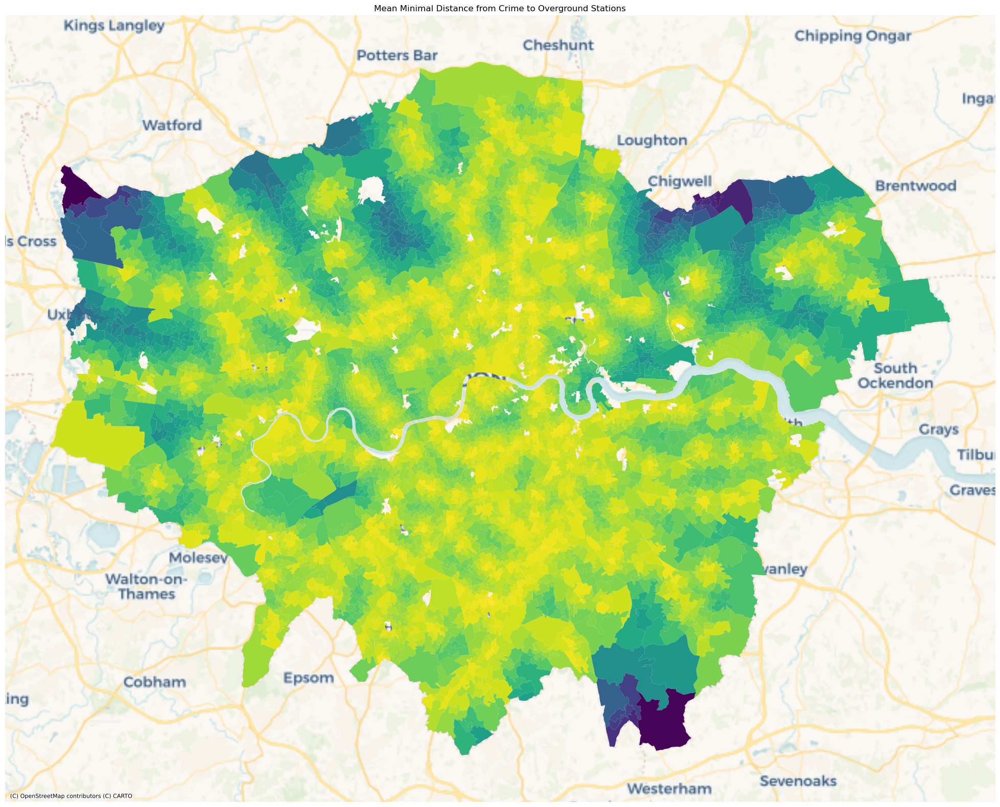

In [ ]:
color_map = plt.cm.get_cmap('viridis')
reversed_color_map = color_map.reversed()
f, ax = plt.subplots(1, figsize=(25, 20)) #Subplots allows you to draw multiple plots in one figure
tmp.to_crs('EPSG:3857').plot('mean_min_distance_overground', cmap=reversed_color_map, marker='.', ax=ax)
ax.set_axis_off() #Remove axes from plot 
ax.set_title('Mean Minimal Distance from Crime to Overground Stations') #Plot title text
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

/opt/anaconda3/lib/python3.11/site-packages/libpysal/weights/util.py:826: UserWarning: The weights matrix is not fully connected: 
 There are 1028 disconnected components.
 There are 779 islands with ids: 22, 23, 26, 27, 29, 30, 34, 65, 68, 80, 83, 87, 88, 95, 99, 105, 126, 138, 153, 154, 155, 171, 175, 181, 182, 188, 192, 193, 199, 201, 208, 215, 219, 227, 235, 236, 237, 240, 241, 242, 243, 245, 246, 247, 248, 252, 262, 264, 265, 266, 268, 272, 276, 277, 291, 295, 301, 311, 314, 315, 317, 321, 335, 341, 348, 350, 351, 356, 360, 361, 362, 363, 364, 366, 367, 368, 369, 370, 371, 372, 374, 375, 376, 385, 387, 391, 392, 401, 408, 411, 412, 414, 417, 419, 427, 428, 430, 431, 432, 441, 444, 445, 449, 453, 455, 468, 469, 473, 497, 499, 515, 516, 539, 540, 545, 546, 554, 584, 587, 594, 595, 616, 619, 620, 622, 624, 625, 626, 627, 628, 629, 630, 631, 632, 634, 635, 636, 637, 638, 639, 640, 641, 646, 647, 648, 649, 651, 653, 654, 655, 656, 657, 658, 662, 663, 664, 665, 666, 667, 681, 682, 683, 

Text(0, 0.5, 'Spatial Lag of Model Residuals - $W u$')

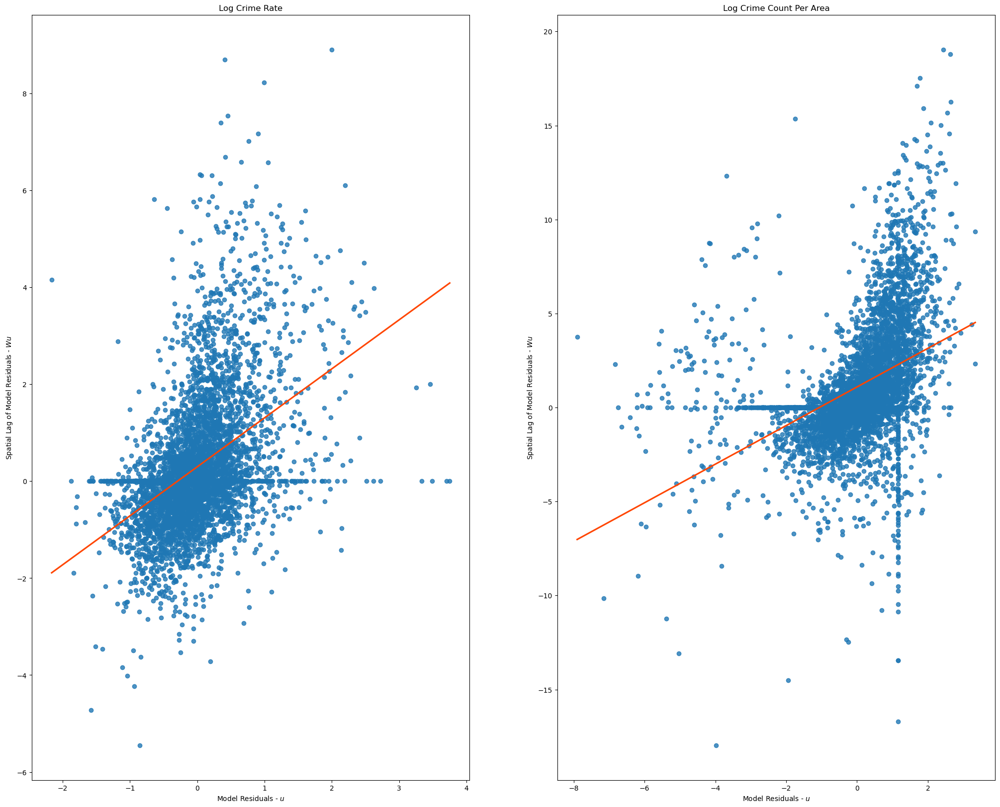

In [ ]:
## spatial lag 

f, axs = plt.subplots(1, 2, figsize=(25, 20))
ax1, ax2 = axs

m2_1 = spreg.OLS(log_overground[['log_crime_rate']].fillna(0).values, log_overground[['log_mean_min_distance_overground']].fillna(0).values)
m2_2 = spreg.OLS(log_overground[['log_CasePerAreaUnit']].fillna(0).values, log_overground[['log_mean_min_distance_overground']].fillna(0).values)

w = weights.DistanceBand.from_dataframe(log_overground, 500) # Weights based on features within 500 meters

lag_residual1 = weights.spatial_lag.lag_spatial(w, m2_1.u)
ax1 = seaborn.regplot(
    x=m2_1.u.flatten(),
    y=lag_residual1.flatten(),
    line_kws=dict(color='orangered'),
    ci=None,
    ax=ax1
)
ax1.set_title('Log Crime Rate')
ax1.set_xlabel('Model Residuals - $u$')
ax1.set_ylabel('Spatial Lag of Model Residuals - $W u$')

lag_residual2 = weights.spatial_lag.lag_spatial(w, m2_2.u)
ax2 = seaborn.regplot(
    x=m2_2.u.flatten(),
    y=lag_residual2.flatten(),
    line_kws=dict(color='orangered'),
    ci=None,
    ax=ax2
)
ax2.set_title('Log Crime Count Per Area')
ax2.set_xlabel('Model Residuals - $u$')
ax2.set_ylabel('Spatial Lag of Model Residuals - $W u$')

('WARNING: ', 22, ' is an island (no neighbors)')
('WARNING: ', 23, ' is an island (no neighbors)')
('WARNING: ', 26, ' is an island (no neighbors)')
('WARNING: ', 27, ' is an island (no neighbors)')
('WARNING: ', 29, ' is an island (no neighbors)')
('WARNING: ', 30, ' is an island (no neighbors)')
('WARNING: ', 34, ' is an island (no neighbors)')
('WARNING: ', 65, ' is an island (no neighbors)')
('WARNING: ', 68, ' is an island (no neighbors)')
('WARNING: ', 80, ' is an island (no neighbors)')
('WARNING: ', 83, ' is an island (no neighbors)')
('WARNING: ', 87, ' is an island (no neighbors)')
('WARNING: ', 88, ' is an island (no neighbors)')
('WARNING: ', 95, ' is an island (no neighbors)')
('WARNING: ', 99, ' is an island (no neighbors)')
('WARNING: ', 105, ' is an island (no neighbors)')
('WARNING: ', 126, ' is an island (no neighbors)')
('WARNING: ', 138, ' is an island (no neighbors)')
('WARNING: ', 153, ' is an island (no neighbors)')
('WARNING: ', 154, ' is an island (no neighbor

/opt/anaconda3/lib/python3.11/site-packages/contextily/tile.py:623: UserWarning: The inferred zoom level of 23 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)
/opt/anaconda3/lib/python3.11/site-packages/contextily/tile.py:623: UserWarning: The inferred zoom level of 23 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


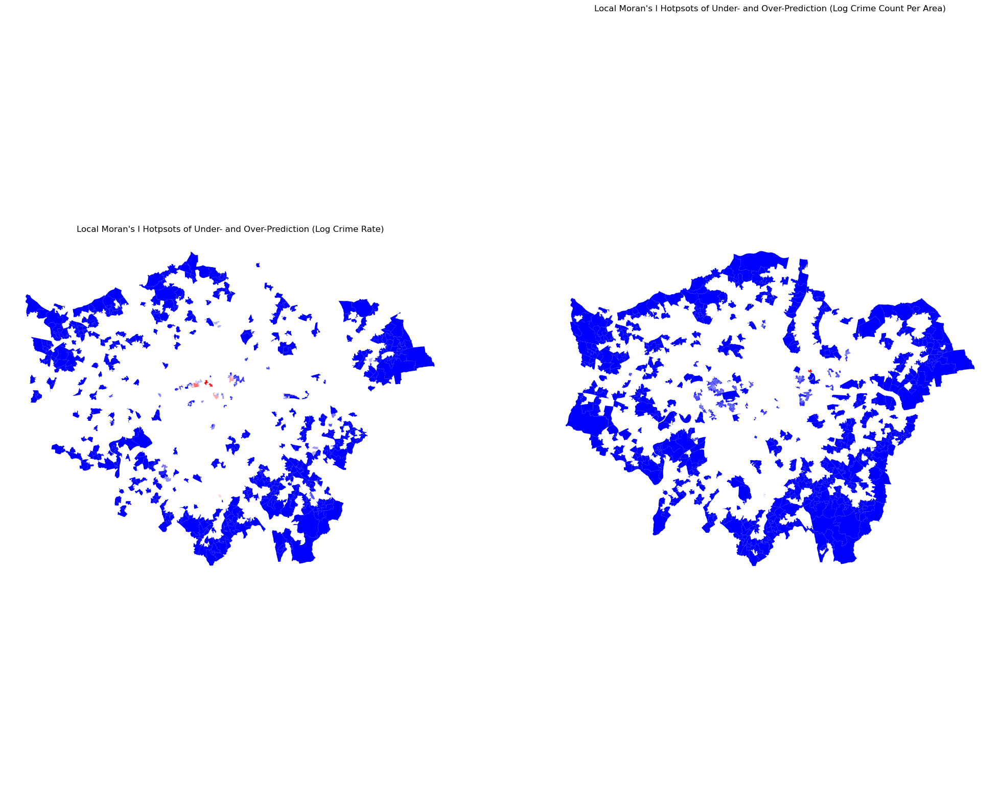

In [ ]:
f, axs = plt.subplots(1, 2, figsize=(25, 20))
ax1, ax2 = axs

outliers = esda.moran.Moran_Local(m2_1.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters

tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='bwr', marker='.', ax=ax1)
ax1.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction (Log Crime Rate)")
ax1.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

outliers = esda.moran.Moran_Local(m2_2.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters

tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='bwr', marker='.', ax=ax2)
ax2.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction (Log Crime Count Per Area)")
ax2.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

### Immigration

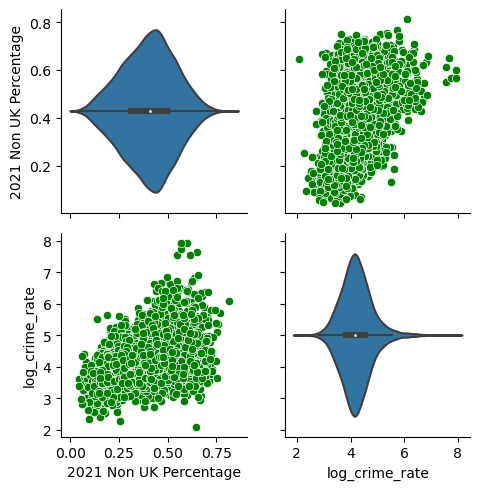

In [52]:
tmp = London_Map_2021.copy()

log_immigration = np.log(tmp[['Level 1/1000 people', 'Level 2/1000 people', 'Level 3/1000 people', 'Level 4/1000 people', 'Apprenticeship/1000 people', 'No qualification/1000 people']])
log_immigration.rename(columns=lambda x: 'log_' + x, inplace=True)
log_immigration['log_crime_rate'] = np.log(tmp['2021 Crime/1000 people'])
log_immigration['geometry'] = tmp['geometry']
log_immigration['2021 Non UK Percentage'] = tmp['2021 Non UK Percentage']

fig = seaborn.PairGrid(log_immigration, vars = ['2021 Non UK Percentage', 'log_crime_rate'])
fig.map_diag(seaborn.violinplot)
fig.map_offdiag(seaborn.scatterplot, color = 'green')

c:\Users\saads\anaconda3\Lib\site-packages\libpysal\weights\util.py:826: UserWarning: The weights matrix is not fully connected: 
 There are 1028 disconnected components.
 There are 779 islands with ids: 22, 23, 26, 27, 29, 30, 34, 65, 68, 80, 83, 87, 88, 95, 99, 105, 126, 138, 153, 154, 155, 171, 175, 181, 182, 188, 192, 193, 199, 201, 208, 215, 219, 227, 235, 236, 237, 240, 241, 242, 243, 245, 246, 247, 248, 252, 262, 264, 265, 266, 268, 272, 276, 277, 291, 295, 301, 311, 314, 315, 317, 321, 335, 341, 348, 350, 351, 356, 360, 361, 362, 363, 364, 366, 367, 368, 369, 370, 371, 372, 374, 375, 376, 385, 387, 391, 392, 401, 408, 411, 412, 414, 417, 419, 427, 428, 430, 431, 432, 441, 444, 445, 449, 453, 455, 468, 469, 473, 497, 499, 515, 516, 539, 540, 545, 546, 554, 584, 587, 594, 595, 616, 619, 620, 622, 624, 625, 626, 627, 628, 629, 630, 631, 632, 634, 635, 636, 637, 638, 639, 640, 641, 646, 647, 648, 649, 651, 653, 654, 655, 656, 657, 658, 662, 663, 664, 665, 666, 667, 681, 682, 683, 6

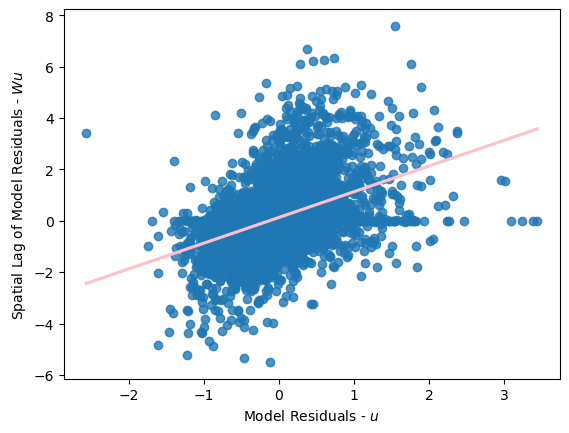

In [53]:
## spatial lag 

m1 = spreg.OLS(log_immigration[['log_crime_rate']].values, log_immigration[['2021 Non UK Percentage']].values)

w = weights.DistanceBand.from_dataframe(log_immigration, 500) # Weights based on features within 500 meters
lag_residual = weights.spatial_lag.lag_spatial(w, m1.u)
ax = seaborn.regplot(
    x=m1.u.flatten(),
    y=lag_residual.flatten(),
    line_kws=dict(color='pink'),
    ci=None,
)
ax.set_xlabel('Model Residuals - $u$')
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$');

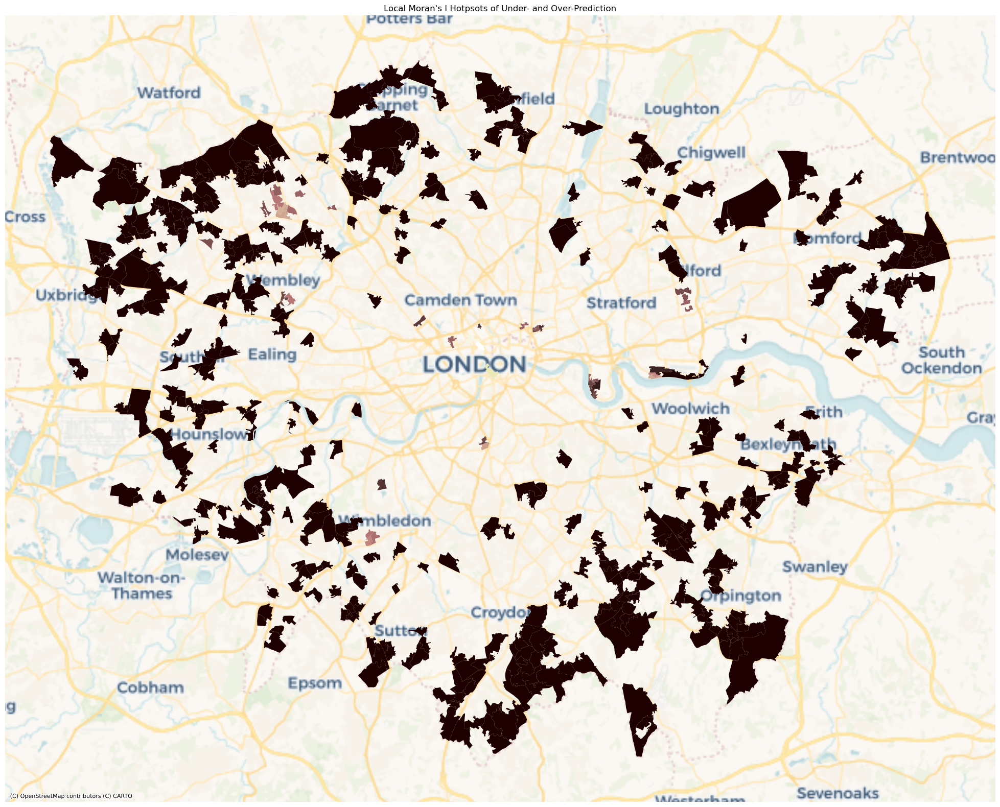

In [58]:

outliers = esda.moran.Moran_Local(m1.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters
f, ax = plt.subplots(1, figsize=(25, 20)) #Subplots allows you to draw multiple plots in one figure
tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='pink', marker='.', ax=ax)
ax.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction")
ax.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

### Police Station

In [59]:
Policestations = pd.read_csv('police-counters.csv')
Policestations.head(5)


,name,local authority,longitude,latitude,status,current,proposed
0,BARKING LEARNING ANNEX,BARKING & DAGENHAM,0.080059,51.537449,keep,24HR,24HR
1,DAGENHAM POLICE STATION,BARKING & DAGENHAM,0.165430,51.545033,cut,24HR,CLOSED
2,COLINDALE POLICE STATION,BARNET,-0.240914,51.596779,keep,24HR,24HR
3,BEXLEYHEATH POLICE STATION,BEXLEY,0.149214,51.456952,keep,24HR,24HR
4,WEMBLEY POLICE STATION,BRENT,-0.305710,51.551516,keep,24HR,24HR


<Axes: >

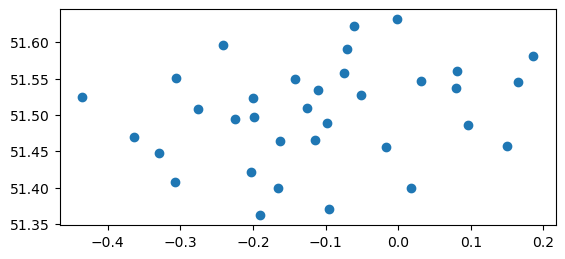

In [60]:
# Identifying points

# Create a GeoDataFrame from the DataFrame
Policestations = gpd.GeoDataFrame(Policestations, geometry=gpd.points_from_xy(Policestations['longitude'], Policestations['latitude']))

# Plot the points. It is noticed that the points dataset covers all the UK.
Policestations.plot()


In [61]:


Policestations.crs = 'EPSG:4326'

print(Policestations.crs)
print(London_Map_2021.crs)


EPSG:4326
EPSG:27700


In [62]:
# Reproject points to EPSG 27700. This had to be done so that the points align with the LSOA polygons.
Policestations_reprojected = Policestations.to_crs(London_Map_2021.crs)

In [63]:
# As I mentiond before the points were for all UK, so I performed a spatial join to determine which LSOA each point belongs to
London_Police_Stations = gpd.sjoin(Policestations_reprojected, London_Map_2021, op='within')
London_Police_Stations = London_Police_Stations.reset_index(drop=True)

# This reduces the dataset to only the geometry of the points. This might keep it simple to calculate distances.
Police_Stations_GeomOnly = London_Police_Stations[['geometry']]


c:\Users\saads\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py:3493: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [64]:
# View of the points within London Only

London_Police_Stations.head(5)

,name,local authority,longitude,latitude,status,current,proposed,geometry,index_right,LSOA Code,...,Level 4+,Other,Level0_1,No qualification/1000 people,Level 1/1000 people,Level0_1/1000 people,Level 2/1000 people,Level 3/1000 people,Level 4/1000 people,Apprenticeship/1000 people
0,BARKING LEARNING ANNEX,BARKING & DAGENHAM,0.080059,51.537449,keep,24HR,24HR,POINT (544357.974 184111.040),4842,E01034473,...,395,45,305,219.047619,103.703704,322.751323,98.412698,91.005291,417.989418,22.222222
1,DAGENHAM POLICE STATION,BARKING & DAGENHAM,0.165430,51.545033,cut,24HR,CLOSED,POINT (550253.221 185126.227),31,E01000036,...,389,34,394,236.909871,101.287554,338.197425,117.596567,131.330472,333.905579,49.785408
2,COLINDALE POLICE STATION,BARNET,-0.240914,51.596779,keep,24HR,24HR,POINT (521940.075 190124.881),4698,E01033917,...,734,53,176,87.167070,54.882970,142.050040,71.832123,120.258273,592.413236,30.669895
3,BEXLEYHEATH POLICE STATION,BEXLEY,0.149214,51.456952,keep,24HR,24HR,POINT (549416.554 175298.540),316,E01000330,...,429,33,444,228.592163,93.613933,322.206096,142.235123,153.846154,311.320755,46.444122
4,WEMBLEY POLICE STATION,BRENT,-0.305710,51.551516,keep,24HR,24HR,POINT (517568.929 184985.288),603,E01000631,...,616,96,584,241.963764,99.357101,341.320865,91.174752,106.954997,360.023378,44.418469


In [65]:
Police_Stations_GeomOnly.head(5)

,geometry
0,POINT (544357.974 184111.040)
1,POINT (550253.221 185126.227)
2,POINT (521940.075 190124.881)
3,POINT (549416.554 175298.540)
4,POINT (517568.929 184985.288)


In [66]:
# Creation of Spatial Weight Matrix (W) from the London_Map_2021
w = weights.Queen.from_dataframe(London_Police_Stations)
# Row-standardization
w.transform = 'R'

C:\Users\saads\AppData\Local\Temp\ipykernel_31624\345145627.py:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(London_Police_Stations)


In [67]:
# Calculation of spatial lag

London_Police_Stations_SpatialCorr = London_Police_Stations.copy() # Creating a copy just in case
London_Police_Stations_SpatialCorr['CrimeRate_Lag'] = weights.spatial_lag.lag_spatial(w, London_Police_Stations_SpatialCorr['2021 Crime/1000 people'])

c:\Users\saads\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py:3493: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


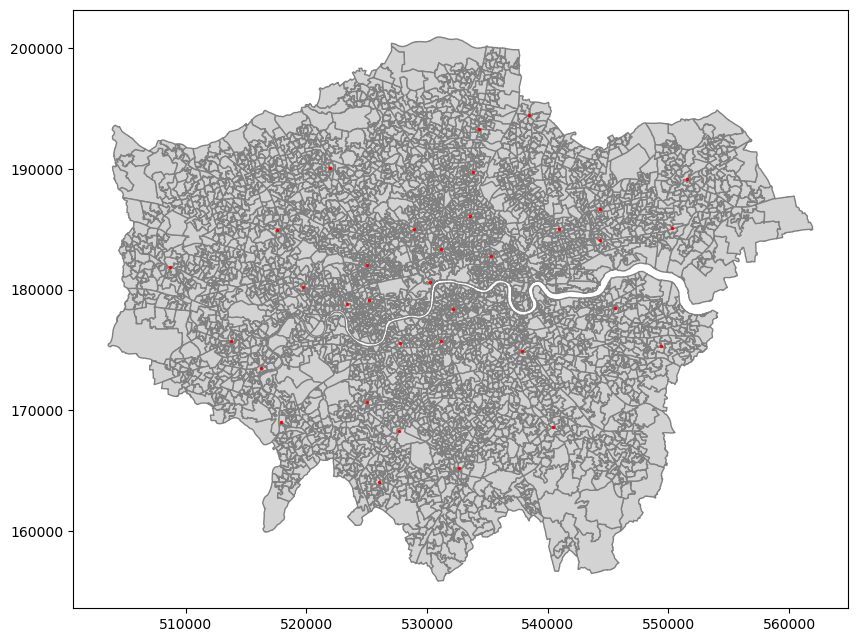

In [68]:
# Read and draw railway stations

#underground = gpd.read_file('underground_stations.geojson')
#underground.crs = 'EPSG:4326'
#stations_reprojected = underground.to_crs(London_Map_2021.crs)

Police_Points = gpd.sjoin(Policestations_reprojected, London_Map_2021, op='within')
Police_Points = Police_Points.reset_index(drop=True)

# This reduces the dataset to only the geometry of the points. This might keep it simple to calculate distances.
Police_Stations_GeomOnly = Police_Points[['geometry']]

fig, ax = plt.subplots(figsize=(10, 10))
London_Map_2021.plot(ax=ax, color='lightgrey', edgecolor='grey')
Police_Stations_GeomOnly.plot(ax=ax, color='red',markersize=2)
plt.show()

In [69]:
London_Crime_Points['Log_crime_rate'] =  np.log10(London_Crime_Points['2021 Crime/1000 people'])


In [72]:
## The nearest distance to the overground station for each crime case

Police_Points = London_Crime_Points.copy()
Police_Points['min_distance_Police_Station'] = Police_Points.geometry.apply(lambda x: Police_Stations_GeomOnly.distance(x).min())
Police_Points.head()

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,...,LAT,LONG,GlobalID,2021 Crime/1000 people,2021 Population,2021 Non UK Percentage,Elementary Sum 2021,Elementary Prop 2021,Log_crime_rate,min_distance_Police_Station
0,59263678a3b555ff49b56c8139a50ae7d726319ad11696...,2021-03,City of London Police,City of London Police,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Violence and sexual offences,...,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,2.264837,1104.180749
1,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126375,51.531512,On or near Shopping Area,E01000953,Camden 022B,Anti-social behaviour,...,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,2.264837,1104.180749
2,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.126699,51.533442,On or near Goods Way,E01000953,Camden 022B,Anti-social behaviour,...,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,2.264837,1097.367973
3,NaN,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.122678,51.535167,On or near Petrol Station,E01000953,Camden 022B,Anti-social behaviour,...,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,2.264837,831.400394
4,032c65a78e935a164f4dc13877de2364976669a77cbc82...,2021-03,Metropolitan Police Service,Metropolitan Police Service,-0.123643,51.530264,On or near Pedestrian Subway,E01000953,Camden 022B,Bicycle theft,...,51.5346,-0.12548,83efcc5c-f476-4407-ab32-44af3d213115,184.008201,1951,0.583803,102,0.136913,2.264837,968.641022


In [73]:
# Now we group the crime case data by the LSOA code then aggregate the mean of distances

Police_Points_grouped = Police_Points.groupby('LSOA code').agg({'min_distance_Police_Station': 'mean', 'GlobalID': 'count'}).reset_index()
Police_Points_grouped.rename(columns={'min_distance_Police_Station': 'mean_min_distance_Police_Station', 'LSOA code': 'LSOA Code', 'GlobalID': 'CaseCount'}, inplace=True)
tmp = tmp.merge(Police_Points_grouped, on='LSOA Code', how='left')

In [74]:
tmp['CasePerAreaUnit'] = tmp['CaseCount']/tmp.geometry.area

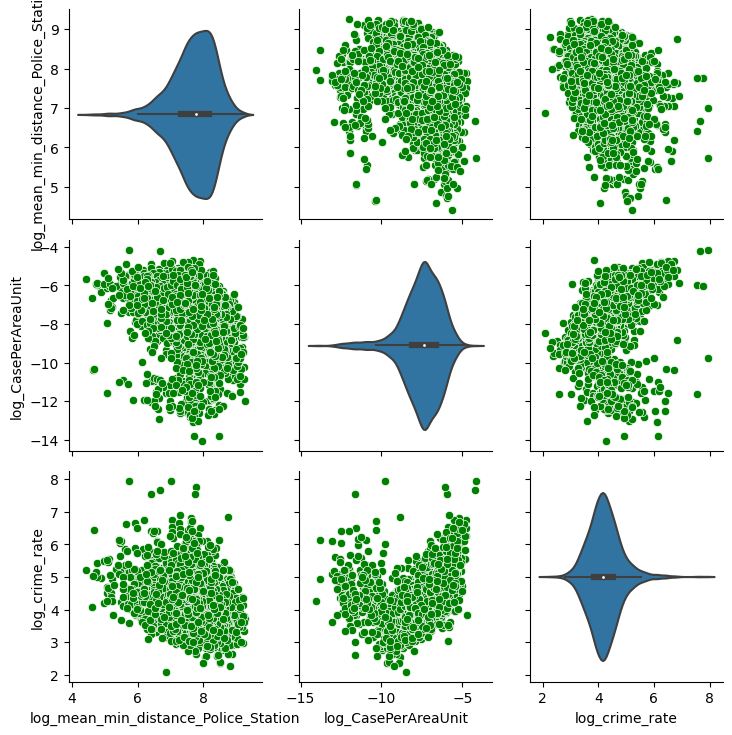

In [75]:
log_Police_Station = np.log(tmp[['mean_min_distance_Police_Station', 'CasePerAreaUnit']])
log_Police_Station.rename(columns=lambda x: 'log_' + x, inplace=True)
log_Police_Station['log_crime_rate'] = np.log(tmp['2021 Crime/1000 people'])
log_Police_Station['geometry'] = tmp['geometry']

fig = seaborn.PairGrid(log_Police_Station, vars = ['log_mean_min_distance_Police_Station', 'log_CasePerAreaUnit', 'log_crime_rate'])
fig.map_diag(seaborn.violinplot)
fig.map_offdiag(seaborn.scatterplot, color = 'green')

C:\Users\saads\AppData\Local\Temp\ipykernel_31624\3253851784.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('inferno')


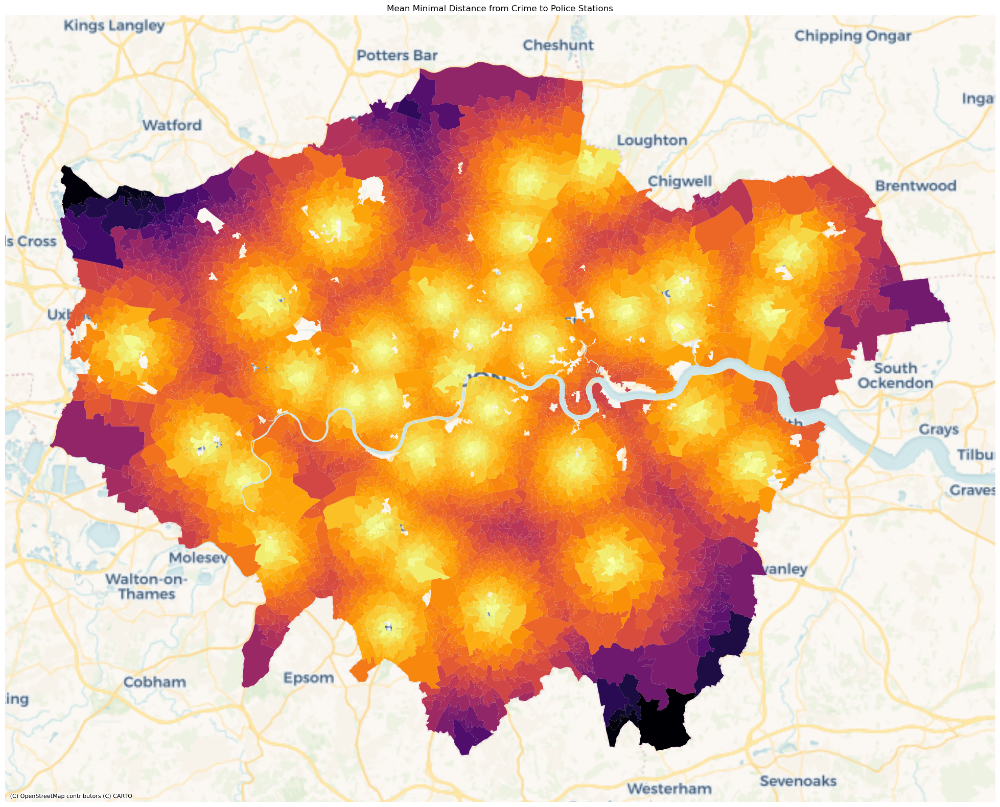

In [76]:
color_map = plt.cm.get_cmap('inferno')
reversed_color_map = color_map.reversed()
f, ax = plt.subplots(1, figsize=(25, 20)) #Subplots allows you to draw multiple plots in one figure
tmp.to_crs('EPSG:3857').plot('mean_min_distance_Police_Station', cmap=reversed_color_map, marker='.', ax=ax)
ax.set_axis_off() #Remove axes from plot 
ax.set_title('Mean Minimal Distance from Crime to Police Stations') #Plot title text
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

c:\Users\saads\anaconda3\Lib\site-packages\libpysal\weights\util.py:826: UserWarning: The weights matrix is not fully connected: 
 There are 1028 disconnected components.
 There are 779 islands with ids: 22, 23, 26, 27, 29, 30, 34, 65, 68, 80, 83, 87, 88, 95, 99, 105, 126, 138, 153, 154, 155, 171, 175, 181, 182, 188, 192, 193, 199, 201, 208, 215, 219, 227, 235, 236, 237, 240, 241, 242, 243, 245, 246, 247, 248, 252, 262, 264, 265, 266, 268, 272, 276, 277, 291, 295, 301, 311, 314, 315, 317, 321, 335, 341, 348, 350, 351, 356, 360, 361, 362, 363, 364, 366, 367, 368, 369, 370, 371, 372, 374, 375, 376, 385, 387, 391, 392, 401, 408, 411, 412, 414, 417, 419, 427, 428, 430, 431, 432, 441, 444, 445, 449, 453, 455, 468, 469, 473, 497, 499, 515, 516, 539, 540, 545, 546, 554, 584, 587, 594, 595, 616, 619, 620, 622, 624, 625, 626, 627, 628, 629, 630, 631, 632, 634, 635, 636, 637, 638, 639, 640, 641, 646, 647, 648, 649, 651, 653, 654, 655, 656, 657, 658, 662, 663, 664, 665, 666, 667, 681, 682, 683, 6

Text(0, 0.5, 'Spatial Lag of Model Residuals - $W u$')

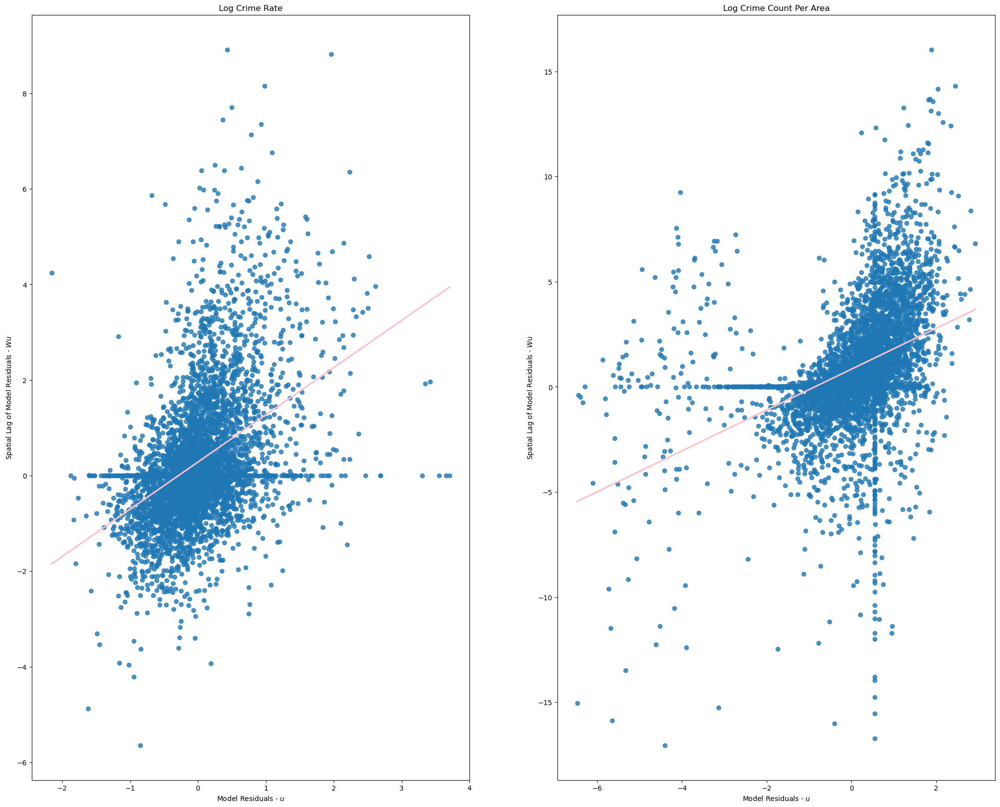

In [77]:
## spatial lag 

f, axs = plt.subplots(1, 2, figsize=(25, 20))
ax1, ax2 = axs

m2_1 = spreg.OLS(log_Police_Station[['log_crime_rate']].fillna(0).values, log_Police_Station[['log_mean_min_distance_Police_Station']].fillna(0).values)
m2_2 = spreg.OLS(log_Police_Station[['log_CasePerAreaUnit']].fillna(0).values, log_Police_Station[['log_mean_min_distance_Police_Station']].fillna(0).values)

w = weights.DistanceBand.from_dataframe(log_Police_Station, 500) # Weights based on features within 500 meters

lag_residual1 = weights.spatial_lag.lag_spatial(w, m2_1.u)
ax1 = seaborn.regplot(
    x=m2_1.u.flatten(),
    y=lag_residual1.flatten(),
    line_kws=dict(color='pink'),
    ci=None,
    ax=ax1
)
ax1.set_title('Log Crime Rate')
ax1.set_xlabel('Model Residuals - $u$')
ax1.set_ylabel('Spatial Lag of Model Residuals - $W u$')

lag_residual2 = weights.spatial_lag.lag_spatial(w, m2_2.u)
ax2 = seaborn.regplot(
    x=m2_2.u.flatten(),
    y=lag_residual2.flatten(),
    line_kws=dict(color='pink'),
    ci=None,
    ax=ax2
)
ax2.set_title('Log Crime Count Per Area')
ax2.set_xlabel('Model Residuals - $u$')
ax2.set_ylabel('Spatial Lag of Model Residuals - $W u$')

('WARNING: ', 22, ' is an island (no neighbors)')
('WARNING: ', 23, ' is an island (no neighbors)')
('WARNING: ', 26, ' is an island (no neighbors)')
('WARNING: ', 27, ' is an island (no neighbors)')
('WARNING: ', 29, ' is an island (no neighbors)')
('WARNING: ', 30, ' is an island (no neighbors)')
('WARNING: ', 34, ' is an island (no neighbors)')
('WARNING: ', 65, ' is an island (no neighbors)')
('WARNING: ', 68, ' is an island (no neighbors)')
('WARNING: ', 80, ' is an island (no neighbors)')
('WARNING: ', 83, ' is an island (no neighbors)')
('WARNING: ', 87, ' is an island (no neighbors)')
('WARNING: ', 88, ' is an island (no neighbors)')
('WARNING: ', 95, ' is an island (no neighbors)')
('WARNING: ', 99, ' is an island (no neighbors)')
('WARNING: ', 105, ' is an island (no neighbors)')
('WARNING: ', 126, ' is an island (no neighbors)')
('WARNING: ', 138, ' is an island (no neighbors)')
('WARNING: ', 153, ' is an island (no neighbors)')
('WARNING: ', 154, ' is an island (no neighbor

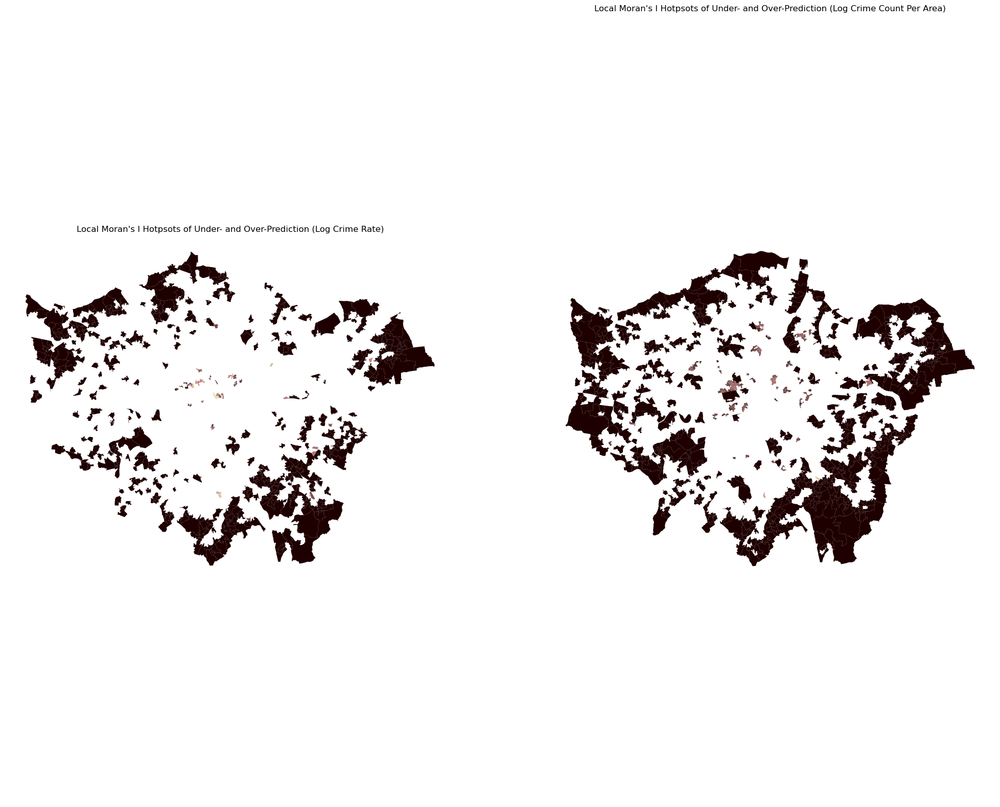

In [78]:
f, axs = plt.subplots(1, 2, figsize=(25, 20))
ax1, ax2 = axs

outliers = esda.moran.Moran_Local(m2_1.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters

tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='pink', marker='.', ax=ax1)
ax1.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction (Log Crime Rate)")
ax1.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)

outliers = esda.moran.Moran_Local(m2_2.u, w, permutations=999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters

tmp.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .to_crs('EPSG:3857')\
  .plot('local_I', cmap='pink', marker='.', ax=ax2)
ax2.set_title("Local Moran's I Hotpsots of Under- and Over-Prediction (Log Crime Count Per Area)")
ax2.set_axis_off() #Remove axes from plot 
plt.axis('equal') #Set x and y axes to be equal size
cx.add_basemap(ax, source=cx.providers.CartoDB.Voyager)